<a href="https://colab.research.google.com/github/luciarc2004-sketch/TFG-Modelado-capas-iono-y-tropo/blob/main/FebreroIII26.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
#!pip install cartopy

from re import U
###Busco crear un mapa que cambie en el tiempo. Resultado de los scrip anteriores
##Animar el día completo

import numpy as np

horas=np.arange(00,24,1);
minutos=np.arange(00,60,5);
segundos=np.arange(00,60,30);
franjashor =np.empty(576, dtype=object); # Changed dtype to object
a=0
i=0;
j=0
a1=0
while a<576: #576 posiciones distintas de horas
  while j<12:
    a1=horas[i] , minutos[j] , segundos[0]
    franjashor[a] = a1
    a=a+1
    a1=horas[i] , minutos[j] , segundos[1]
    franjashor[a] = a1
    a=a+1
    j=j+1;
  i=i+1;
  j=0

# Convert np.int64 values in tuples to standard Python int
for idx, item in enumerate(franjashor):
    franjashor[idx] = tuple(int(x) for x in item)

#aqui buscamos que tenga el formato que corresponde a la página: tanto con / como -
i=0
franjashor2=franjashor.copy()
while i<576:
  t = franjashor2[i]
  resultado = f"{t[0]:02d}/{t[1]:02d}/{t[2]:02d}"
  franjashor2[i] = resultado
  i=i+1

i=0
while i<576:
  t = franjashor[i]
  resultado = f"{t[0]}-{t[1]}-{t[2]}"
  franjashor[i] = resultado
  i=i+1



##AÑADIR INPUTS
#generar posición del día respecto del año; debenos entrar nosotros dia/mes/año
import datetime
import calendar
selecdia=28
selecmes=8
selecaño=2025
juliano=selecdia
i=1
while i<selecmes:
  juliano=juliano+calendar.monthrange(selecaño, i)[1]
  # la funcion monthrange nos da dos valores; el de inicio(0) y el último dia, nos intersa el segundo.
  i=i+1
#juliano ya nos da el dia que necesita el link:


import numpy as np
latitudes=np.arange(-90,92.5,2.5)
longitudes=np.arange(-180,185,5)

import requests #request puedo añadir URL al código
import re

long=[]
longitudes=np.arange(-180,185,5)
i=0
j=1
#long=[longitudes]
lat=[-90]
while i<73:
  a=-90+i*2.5
  while j<73:
   lat.append((a))
   j=j+1
  j=0

  long=np.append(long,[longitudes])
  i=i+1

long=np.array(long)
lat=np.array(lat)

import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature

Aqui empiezo a buscar para graficar 24h, 576 mapas

In [9]:
##horafin debe tener segundos 00
##es decir, horaini debe tener segundos en 30. no vale cualquier i, solo los pares.
i=0
URLs=[]
matriz_24h = [] # Initialize as a list to collect arrays
while i<84:  ##luego cambiar a 576
  if i% 2 != 0:
    i=i-1   #se debe seleccionar el i que busco
  partes=franjashor[i].split("-");
  horafin=f"{int(partes[0]):02d}-{int(partes[1]):02d}-{int(partes[2]):02d}"
  partes_horaini=franjashor[i-1].split("-"); # Split franjashor[i-1] into parts
  horaini=f"{int(partes_horaini[0]):02d}-{int(partes_horaini[1]):02d}-{int(partes_horaini[2]):02d}" # Access franjashor by index, not call it
  #debo añadir formato a la hora
  hora=int(partes[0])

  a="https://impc.dlr.de/SWE/Total_Electron_Content/TEC_Near_Real-Time/DLR_GNSS_GCG_L4_VTEC-NTCM-SCM_NC_GLOBAL/v2.0.0/"
  #2025/234/00    varía en año, dia juliano y franja horaria
  b=str(selecaño)+'/'+str(juliano)+'/'+f"{hora:02d}"  ###MIRAR HORA ESTE EN FORMATO
  c="/DLR_GNSS_GCG_L4_VTEC-NTCM-SCM_NC_GLOBAL_"

  #2025-08-21T23-55-30_2025-08-22T00-00-00_234_D.json   fecha normal+ hora empeiza recuento; fecha normal + hora termina recuento
  ##calculo empieza y termina el recuento
  d=str(selecaño)+"-"+f"{selecmes:02d}"+"-"+f"{selecdia:02d}"+"T"+horaini+"_"+str(selecaño)+"-"+f"{selecmes:02d}"+"-"+f"{selecdia:02d}"+"T"+horafin+"_"+str(juliano)+"_D.json"
  link=a+b+c+d
  URLs.append(link)
  #en verdad podria continuar aqui el codigo para sacar los datos
  i=i+2

  r = requests.get(link)
  texto=r.text
  # NOTE: The kernel state shows r.text contains PNG data, not JSON. This will likely make `resultado` an empty list.
  resultado=re.findall(r'"vtec_assimilated_tecu":\s*([^,]+)',texto)
  todos= {i:resultado for i, resultado in enumerate(resultado)}


  z=0
  matriz=[]
  while z<73:
      # If resultado is empty, this will produce empty slices
      a=resultado[z*73:z*73+73]
      matriz.append(a)
      a=0
      z=z+1
  resultado_numeric = np.array(resultado, dtype=float)  #este es el vector que debo añadir a la matriz
  matriz_24h.append(resultado_numeric) # Append to the list
  matriz_24h_ =  [arr.tolist() for arr in matriz_24h if len(arr) > 0]
print(matriz_24h_)


[[3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.107, 3.164, 3.088, 3.026, 2.977, 2.944, 2.927, 2.924, 2.934, 2.958, 2.993, 3.038, 3.09, 3.149, 3.212, 3.276, 3.341, 3.404, 3.463, 3.518, 3.565, 3.604, 3.634, 3.654, 3.664, 3.662, 3.65, 3.626, 3.592, 3.548, 3.495, 3.434, 3.366, 3.295, 3.221, 3.146, 3.073, 3.004, 2.941, 2.887, 2.843, 2.812, 2.794, 2.79, 2.802, 2.83, 2.873, 2.931, 3.003, 3.086, 3.18, 3.28, 3.385, 3.492, 3.597, 3.698, 3.79, 3.872, 3.941, 3.994, 4.03, 4.047, 4.044, 4.021, 3.98, 3.92, 3.845, 3.757, 3.659, 3.556, 3.451, 3.349, 

Una vez tenemos la lista de listas con los valores correspondiente a 24h: "matriz_24h_" debemos representar ese cambio en el mapa.

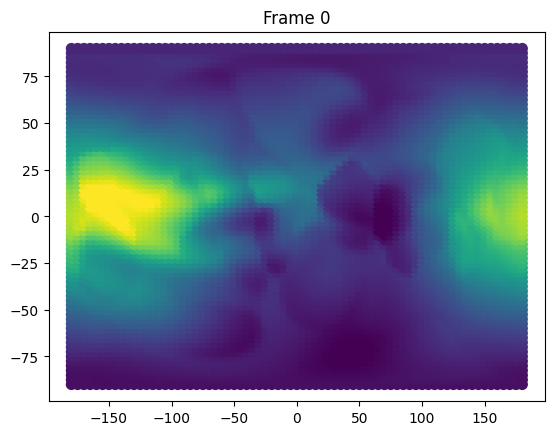

In [42]:
#Segundo intento de representar
#!pip install cartopy
import numpy as np
import matplotlib.pyplot as plt

fig, ax = plt.subplots()
scatter = ax.scatter(long, lat, c=matriz_24h_[40], cmap='viridis', s=50)


def update(frame):
    scatter.set_array(datos_tiempo[frame])
    ax.set_title(f'Frame {frame}')  #cambiar título a momento del día
    return scatter,

from matplotlib.animation import FuncAnimation
ani = FuncAnimation(fig, update, frames=40, interval=100)
from IPython.display import HTML
HTML(ani.to_jshtml())



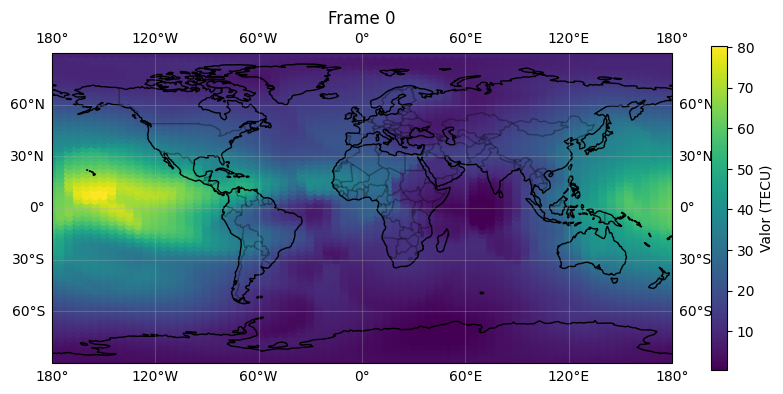

In [48]:
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import numpy as np
from matplotlib.animation import FuncAnimation
import time

datos_tiempo = np.array(matriz_24h_)


#datos de la figura
fig = plt.figure(figsize=(10, 6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.add_feature(cfeature.COASTLINE)
ax.add_feature(cfeature.BORDERS, alpha=0.3)
ax.gridlines(draw_labels=True, alpha=0.3)



#creo la imagen original, vacía
scatter = ax.scatter(long, lat, c=datos_tiempo[0], s=40, cmap='viridis',
                     transform=ccrs.PlateCarree());

cbar = plt.colorbar(scatter, ax=ax, shrink=0.7, label='Valor (TECU)')

##POR QUÉ NO ENTRA EN LA FUNCIÓN update???
def update(frame):
    scatter.set_array(datos_tiempo[frame])
    ax.set_title(f'Frame {frame}')  #cambiar título
    return scatter,

from matplotlib.animation import FuncAnimation
ani = FuncAnimation(fig, update, frames=(len(datos_tiempo)), interval=500)
from IPython.display import HTML
HTML(ani.to_jshtml())
